# 🌊oceanoGRAPH: Graph Neural Networks in Ocean Temperature Prediction (Argo Floats)

## Imports

In [ ]:
%%capture
# Packages to download and work with the argofloat data
## The above line supresses the output of the cell
!pip install argopy
import argopy
from argopy import DataFetcher, set_options

import numpy as np
import netCDF4
import xarray as xr

!pip install cartopy
import cartopy.crs as ccrs
import cartopy

import matplotlib as mpl
import matplotlib.cm as cm
from matplotlib import pyplot as plt;
#%matplotlib inline


### Packages used to convert Argofloat NETCDF data to a graph (using NetworkX)
import xarray as xr
import networkx as nx
!pip install haversine
from haversine import haversine


### Packages used to construct the Graph Neural Network
!pip install -q torch

import os
import torch
os.environ['TORCH'] = torch.__version__
os.environ['PYTHONWARNINGS'] = "ignore"
!pip install torch-scatter -f https://data.pyg.org/whl/torch-${TORCH}.html
!pip install torch-sparse -f https://data.pyg.org/whl/torch-${TORCH}.html
!pip install git+https://github.com/pyg-team/pytorch_geometric.git

from torch_geometric.nn import GCNConv
from torch_geometric.utils import from_networkx
import torch.nn.functional as F
import torch.nn as nn

from torch.optim import Adam, SGD

> Fetching Argopy data

In [ ]:
set_options(api_timeout=300, mode='expert')

(<Figure size 900x540 with 1 Axes>,
 <Axes: xlabel='longitude', ylabel='latitude'>)

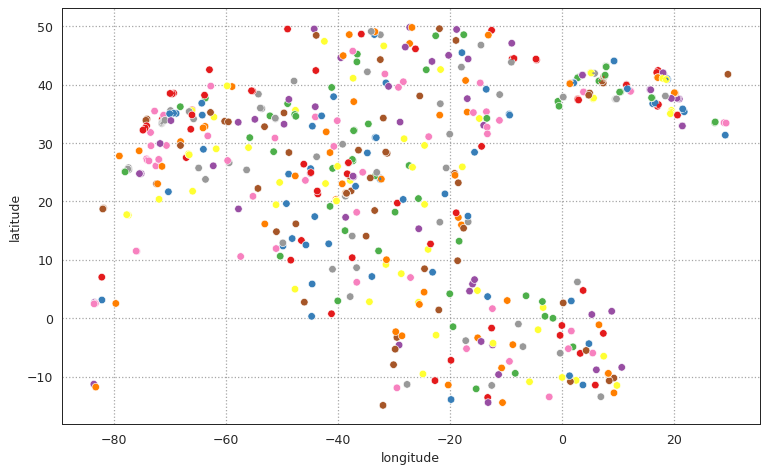

In [ ]:
# !!!!NOTE: These next 4 cells take /very long/ to run when converting to xarrays, avoid running again. You can run these cells in the beginning and use the datasets for the rest of the code.
    #Also, if you receive ProxyError, just run the cell again until it works. This is a common occurrence and the data will get loaded eventually.
    #Cells have been split into separate blocks to avoid having to rerun everything due to one of these errors.

ArgoSet = DataFetcher().region([-85,30,-15,50,0,10,'2013-08-01','2013-08-11']) #Region 1
ds = ArgoSet.to_xarray()
ArgoSet.plot('trajectory')

(<Figure size 900x540 with 1 Axes>,
 <Axes: xlabel='longitude', ylabel='latitude'>)

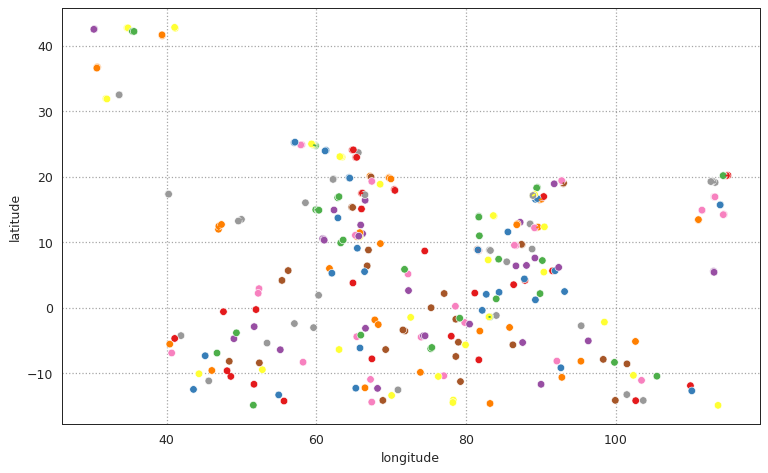

In [ ]:
ArgoSet_2 = DataFetcher().region([30,115,-15,50,0,10,'2013-08-01','2013-08-11']) #Region 2
ds_2 = ArgoSet_2.to_xarray()
ArgoSet_2.plot('trajectory')

(<Figure size 900x540 with 1 Axes>,
 <Axes: xlabel='longitude', ylabel='latitude'>)

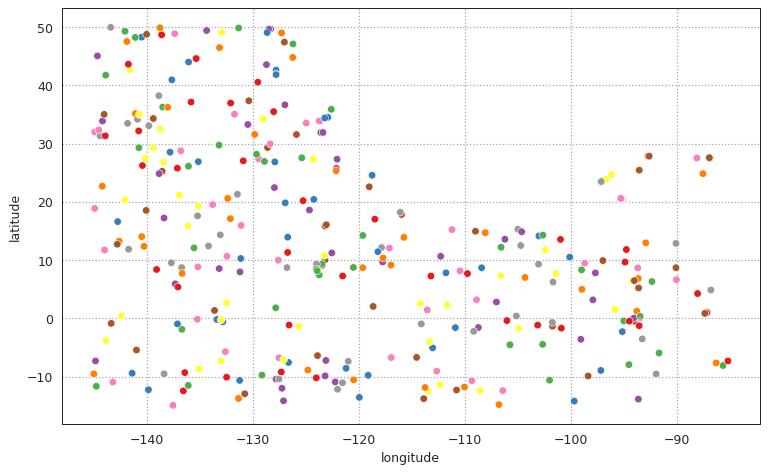

In [ ]:
ArgoSet_3 = DataFetcher().region([-145,-85,-15,50,0,10,'2013-08-01','2013-08-11']) #Region 3
ds_3 = ArgoSet_3.to_xarray()
ArgoSet_3.plot('trajectory')

(<Figure size 900x540 with 1 Axes>,
 <Axes: xlabel='longitude', ylabel='latitude'>)

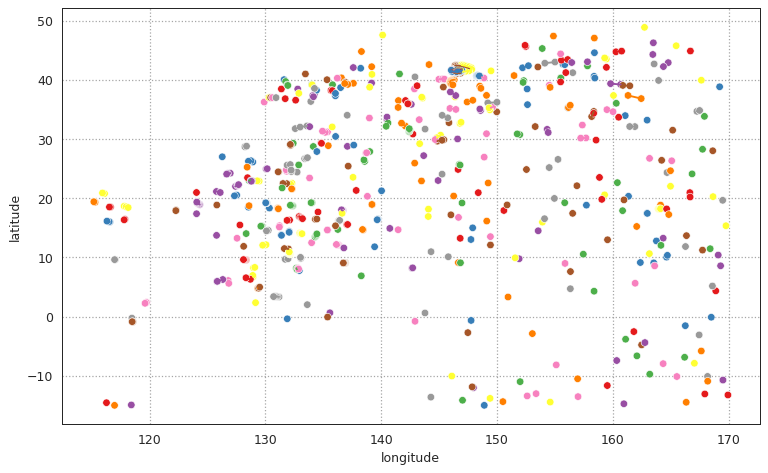

In [ ]:
ArgoSet_4 = DataFetcher().region([115,170,-15,50,0,10,'2013-08-01','2013-08-11']) #Region 4
ds_4 = ArgoSet_4.to_xarray()
ArgoSet_4.plot('trajectory')

## Data preprocessing

In [ ]:
#Merging all 4 datasets (ds, ds_2, ds_3, and ds_4) into concat_ds
concat_ds = xr.concat([ds, ds_2, ds_3, ds_4], dim='N_POINTS')

In [ ]:
#Removing NAN values from dataset

#1.Get parameter values
device_ids = concat_ds['PLATFORM_NUMBER'].values
latitudes = concat_ds['LATITUDE'].values
longitudes = concat_ds['LONGITUDE'].values
temperatures = concat_ds['TEMP'].values
salinity = concat_ds['PSAL'].values
pressure = concat_ds['PRES'].values

#2. Get all non NAN indexes
mask_nan = ~np.isnan(device_ids) & ~np.isnan(latitudes) & ~np.isnan(longitudes) & ~np.isnan(temperatures) & ~np.isnan(salinity) & ~np.isnan(pressure)

#3. Keep all non NAN indexes
device_ids = device_ids[mask_nan]
latitudes = latitudes[mask_nan]
longitudes = longitudes[mask_nan]
temperatures = temperatures[mask_nan]
salinity = salinity[mask_nan]
pressure = pressure[mask_nan]


print("Number of measurements:", len(device_ids))

#Print debugging statements, uncomment as needed
##print(len(device_ids), len(latitudes), len(longitudes), len(temperatures), len(salinity), len(pressure)) #Ensure all these values are the same

Number of measurements: 6438


> Make data into graph

In [ ]:
#MakeGraph(r): Function which takes a dataset an xarray and a radial threshold value in kilometers (r) and returns a networkx graph
def MakeGraph(r):
  G = nx.Graph()
  # Creating the Nodes of the graph
  for i, device_id in enumerate(device_ids):
    #Add target under 'y' and features into 'x'
    G.add_nodes_from([ (device_id, {'x': torch.tensor([latitudes[i], longitudes[i], salinity[i], pressure[i]]), 'y': torch.tensor(temperatures[i])})])

  # Adding edges between nodes that are within the radial threshold
  for i in range(len(device_ids)):
    for j in range(i + 1, len(device_ids)):
        dist = haversine((latitudes[i], longitudes[i]), (latitudes[j], longitudes[j]))
        if dist <= r and dist > 0:
            G.add_edge(device_ids[i], device_ids[j], weight=dist)
    G.remove_edges_from(nx.selfloop_edges(G))
  return G

In [ ]:
#DrawGraph(graph): Plots a networkx graph in an image
def DrawGraph(graph):
  pos = {device_id: (longitudes[i], latitudes[i]) for i, device_id in enumerate(device_ids)} #Get node positions
  fig = plt.figure(figsize=(150,60), dpi=60) #Set figure parameters
  nx.draw(graph, pos, with_labels=False, node_size=750)
  #nx.draw_spring(G, with_labels=True, node_size=50) # Replace with previous line if you want to use, spring option shows a larger difference between nodes that are connected and nodes that are not
  plt.show()
  return

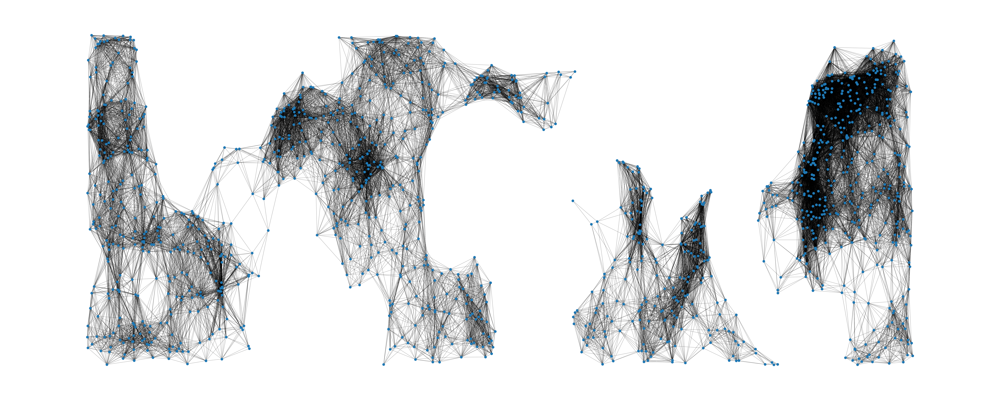

In [ ]:
G = MakeGraph(1250)
DrawGraph(G)

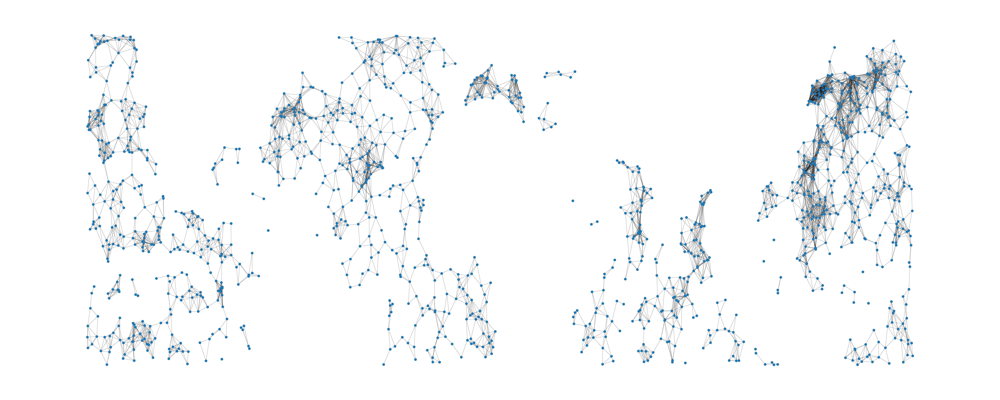

In [ ]:
G2 = MakeGraph(500)
DrawGraph(G2)

In [ ]:
#Make the graph to train the model on
D = MakeGraph(500)
# Graphs with alternative radial thresholds:
# D = MakeGraph(100)
# D = MakeGraph(500)
# D = MakeGraph(750)
# D = MakeGraph(1250)
# D = MakeGraph(1500)
# D = MakeGraph(5000)

# Convert NetworkX graph to PyTorch Geometric format
data = from_networkx(D)

# Check the resulting data object
print(data)

#Now this data object is ready to train in our model!

Data(x=[1387, 4], edge_index=[2, 28072], y=[1387], weight=[28072])


> Train/Test Split

In [ ]:
#Make masks that will hold the indices of the values that are split into test and train
num_nodes = len(data.x)
train_mask = torch.zeros(num_nodes, dtype=torch.bool)
test_mask = torch.zeros(num_nodes, dtype=torch.bool)
val_mask = torch.zeros(num_nodes, dtype=torch.bool)

indices = np.arange(num_nodes)
np.random.shuffle(indices)

#Get indices of split
train_indices = indices[:int(0.8 * num_nodes)]  # 80% for training
val_indices = indices[int(0.8 * num_nodes):int(0.9 * num_nodes):]  # 10% for validation
test_indices = indices[int(0.9 * num_nodes):]  # 10% for testing

#Make the arrays with the indices
train_mask[train_indices] = True
test_mask[test_indices] = True
val_mask[val_indices] = True

> Normalise Data

In [ ]:
train_features = []
train_targets = []
temp_vals = [];
sal_vals = [];
pres_vals = [];

#Get values of parameters
for i in range(len(train_mask)):
  if train_mask[i]:
    train_features.append(data.x[i])
    train_targets.append(data.y[i])
    sal_vals.append(data.x[i][1])
    pres_vals.append(data.x[i][2])
    temp_vals.append(data.y[i])

#Calculate mean and std of parameters
temp_mean = np.mean(temp_vals)
sal_mean = np.mean(sal_vals)
pres_mean = np.mean(pres_vals)

temp_std = np.std(temp_vals)
sal_std = np.std(sal_vals)
pres_std = np.std(pres_vals)

print("Mean temperature:",temp_mean, " Std dev temperature:", temp_std)
print("Mean salinity:",sal_mean, " Std dev salinity:", sal_std)
print("Mean pressure:",pres_mean, " Std dev pressure:", pres_std)

#Normalise data based on calculated mean and std dev
for k in range(len(data.x)):
  data.x[k][1] = (data.x[k][1] - sal_mean) / sal_std
  data.x[k][2] = (data.x[k][2] - pres_mean) / pres_std
  data.y[k] = (data.y[k] - temp_mean) / temp_std

print(data.x)

Mean temperature: -0.01668269  Std dev temperature: 1.0206926
Mean salinity: -0.004821459168392592  Std dev salinity: 0.9845989202063391
Mean pressure: -0.01939196676440885  Std dev pressure: 1.089832952534504
tensor([[ 4.1222e+01,  3.5297e-03,  9.3595e-01,  9.6000e+00],
        [ 2.9927e+01, -8.5289e-01,  5.5603e-01,  1.0000e+01],
        [-9.4463e+00, -8.1514e-02,  4.6605e-01,  9.0000e+00],
        ...,
        [ 2.5426e+01,  1.1619e+00, -5.4679e-02,  1.0000e+01],
        [ 2.1746e+01,  1.1068e+00, -8.8004e-02,  1.0000e+01],
        [ 2.1263e+01,  1.1896e+00, -1.1354e-02,  9.4000e+00]],
       dtype=torch.float64)


##GNN Models

In [ ]:
#Default GNN Model architecture
class GNNNodeRegressor(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super().__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, out_channels)

    def forward(self, x, edge_index):
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = self.conv2(x, edge_index)
        return x

In [ ]:
from torch.nn import Dropout

#GNN Model with more layers + dropout
class GNNNodeRegressor_Dropout(nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels, dropout=0.5):
        super().__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, hidden_channels)
        self.conv3 = GCNConv(hidden_channels, out_channels)
        self.dropout = Dropout(dropout)

    def forward(self, x, edge_index):
        x = F.relu(self.conv1(x, edge_index))
        x = self.dropout(x)  # Apply dropout
        x = F.relu(self.conv2(x, edge_index))
        x = self.conv3(x, edge_index)
        return x

##Training

> Default architecture

In [ ]:
import torch.nn as nn

# Initialize the model
model = GNNNodeRegressor(
    in_channels=data.x.size(1),  # Number of input features
    hidden_channels=64,         # Hidden layer size
    out_channels=1              # Output size (regression target: temperature)
)

# Optimizer, loss function, epochs
optimizer = Adam(model.parameters(), lr=0.3)
#loss_fn = nn.MSELoss()
loss_fn = nn.HuberLoss(delta=0.5) #Replace with above to use Huber loss
num_epochs = 750

train_losses1=[]
val_losses1=[]

# Training loop
model.train()

for epoch in range(num_epochs):
    optimizer.zero_grad()
    out = model(data.x.to(torch.float32), data.edge_index)  # Predict temperatures for all nodes
    loss = loss_fn(out[train_mask], data.y[train_mask])  # Compute loss on training nodes
    loss.backward()
    train_losses1.append(loss.item())
    optimizer.step()

    #Calculate validation loss
    with torch.no_grad():
      val_loss = loss_fn(out[val_mask], data.y[val_mask])
      val_losses1.append(val_loss.item())

    if epoch % 100 == 0:
      print(f"Epoch {epoch + 1:>3} | Train Loss: {loss.item():.3f} | Val Loss: {val_loss.item():.3f}")

# Evaluate on test set
model.eval()
with torch.no_grad():
    predictions = model(data.x.to(torch.float32), data.edge_index)
    test_loss = loss_fn(predictions[test_mask], data.y[test_mask])
    print(f"Test Loss: {test_loss.item()}")


/usr/local/lib/python3.10/dist-packages/torch/nn/modules/loss.py:1100: UserWarning: Using a target size (torch.Size([1109])) that is different to the input size (torch.Size([1109, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.huber_loss(input, target, reduction=self.reduction, delta=self.delta)
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/loss.py:1100: UserWarning: Using a target size (torch.Size([139])) that is different to the input size (torch.Size([139, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.huber_loss(input, target, reduction=self.reduction, delta=self.delta)


Epoch   1 | Train Loss: 0.362 | Val Loss: 0.358
Epoch 101 | Train Loss: 0.256 | Val Loss: 0.238
Epoch 201 | Train Loss: 0.256 | Val Loss: 0.239
Epoch 301 | Train Loss: 0.256 | Val Loss: 0.239
Epoch 401 | Train Loss: 0.256 | Val Loss: 0.239
Epoch 501 | Train Loss: 0.256 | Val Loss: 0.239
Epoch 601 | Train Loss: 0.256 | Val Loss: 0.239
Epoch 701 | Train Loss: 0.256 | Val Loss: 0.239
Test Loss: 0.2185482531785965


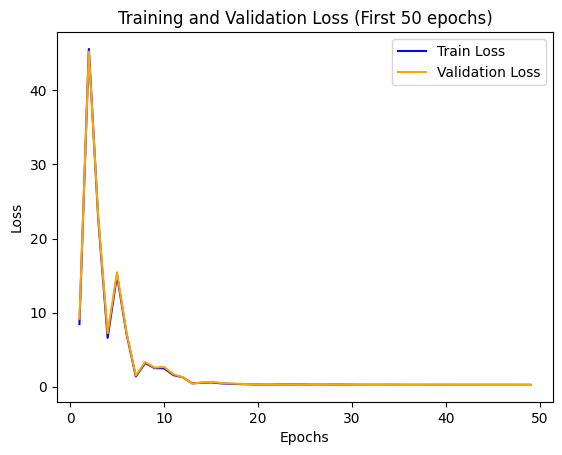

In [ ]:
#Plotting training and validation loss

epochs = range(1,50) # Note: For improved visual scale consider using epochs = range(2,50)
plt.plot(epochs, train_losses1[1:50], 'b', label='Train Loss')
plt.plot(epochs, val_losses1[1:50], c='orange', label='Validation Loss')
plt.title('Training and Validation Loss (First 50 epochs)')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

> More layers & Dropout

In [ ]:
# Initialize the model
model = GNNNodeRegressor_Dropout(
    in_channels=data.x.size(1),  # Number of input features
    hidden_channels=4,           # Hidden layer size
    out_channels=1               # Output size (regression target: temperature)
)

# Optimizer, loss function, epochs
optimizer = Adam(model.parameters(), lr=0.001)
# Alternative Optimizers:
# optimizer = SGD(model.parameters(), momentum=0, lr=0.001)
# optimizer = SGD(model.parameters(), momentum=0.5, lr=0.001)
# optimiser = SGD(model.parameters(), momentum=0.3, lr=0.01)

# loss_fn = nn.MSELoss() #Change to this if you want to
loss_fn = nn.HuberLoss(delta=0.5)
num_epochs = 750

train_losses2=[]
val_losses2=[]

# Training loop
model.train()

for epoch in range(num_epochs):  # Train for 100 epochs
    optimizer.zero_grad()
    out = model(data.x.to(torch.float32), data.edge_index)  # Predict temperatures for all nodes
    loss = loss_fn(out[train_mask], data.y[train_mask])  # Compute loss on training nodes
    loss.backward()
    train_losses2.append(loss.item())
    optimizer.step()

    #Calculate validation loss
    with torch.no_grad():
      val_loss = loss_fn(out[val_mask], data.y[val_mask])
      val_losses2.append(val_loss.item())

    if epoch % 100 == 0:
      print(f"Epoch {epoch + 1:>3} | Train Loss: {loss.item():.3f} | Val Loss: {val_loss.item():.3f}")


# Evaluate on test set
model.eval()
with torch.no_grad():
    predictions = model(data.x.to(torch.float32), data.edge_index)
    test_loss = loss_fn(predictions[test_mask], data.y[test_mask])
    print(f"Test Loss: {test_loss.item()}")

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/loss.py:1100: UserWarning: Using a target size (torch.Size([1109])) that is different to the input size (torch.Size([1109, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.huber_loss(input, target, reduction=self.reduction, delta=self.delta)
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/loss.py:1100: UserWarning: Using a target size (torch.Size([139])) that is different to the input size (torch.Size([139, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.huber_loss(input, target, reduction=self.reduction, delta=self.delta)


Epoch   1 | Train Loss: 0.400 | Val Loss: 0.412
Epoch 101 | Train Loss: 0.272 | Val Loss: 0.264
Epoch 201 | Train Loss: 0.257 | Val Loss: 0.242
Epoch 301 | Train Loss: 0.257 | Val Loss: 0.241
Epoch 401 | Train Loss: 0.256 | Val Loss: 0.240
Epoch 501 | Train Loss: 0.256 | Val Loss: 0.240
Epoch 601 | Train Loss: 0.256 | Val Loss: 0.239
Epoch 701 | Train Loss: 0.256 | Val Loss: 0.239
Test Loss: 0.2189854383468628


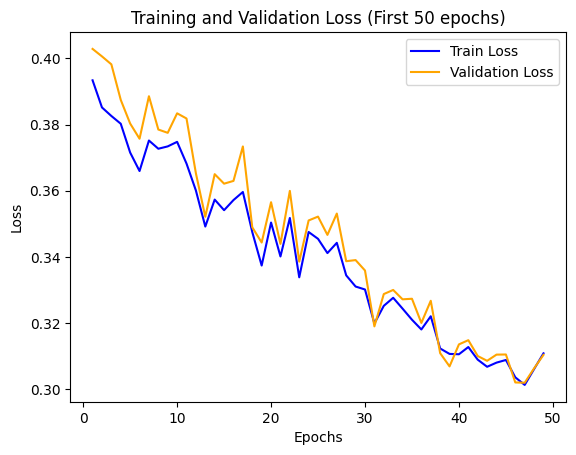

In [ ]:
#Plotting training and validation loss

epochs = range(1,50)
plt.plot(epochs, train_losses2[1:50], 'b', label='Train Loss')
plt.plot(epochs, val_losses2[1:50], c='orange', label='Validation Loss')
plt.title('Training and Validation Loss (First 50 epochs)')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()